---
<br>

# CPE342 Machine Learning
# Assignment 2 : Decision Tree lab

### Group Member
    1.   Kittapong  Moosikerd  64070501001
    2.   Chalisa  Jarernsawat  64070501016
    3.   Witchayaporn Sabkerd  64070501045
    4.   Sarita  Thongbankor   64070501050
    5.   Angwara  Somthawin    64070501056
<br>

---

In [1]:
import warnings

warnings.filterwarnings("ignore")
warnings.simplefilter(action="ignore",category=UserWarning)
warnings.simplefilter(action="ignore",category=FutureWarning)

# Suppress valuewarning when fitting ARIMA model.
from statsmodels.tools.sm_exceptions import ValueWarning
warnings.simplefilter('ignore', ValueWarning)


# Interactive plots embedded within the notebook
#%matplotlib notebook 
# Static images of plots embedded within the notebook
%matplotlib inline   
%config InlineBackend.figure_formats = {'png', 'retina'}

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# Decision Tree 

## Load data

In [2]:
import pandas as pd
enroll_df = pd.read_excel('data/tree-based.xlsx', sheet_name='ENROLL')

<font color='blue'>Look at the first few rows

In [3]:
enroll_df.head()

,Age,Income,Jobsatisfaction,Desire,Enrolls
0,<=30,High,No,Fair,No
1,<=30,High,No,Excellent,No
2,31 to 40,High,No,Fair,Yes
3,>40,Medium,No,Fair,Yes
4,>40,Low,Yes,Fair,Yes


<font color='blue'>Inspect basic information of dataset

In [4]:
enroll_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14 entries, 0 to 13
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Age              14 non-null     object
 1   Income           14 non-null     object
 2   Jobsatisfaction  14 non-null     object
 3   Desire           14 non-null     object
 4   Enrolls          14 non-null     object
dtypes: object(5)
memory usage: 688.0+ bytes


In [5]:
# Rename column
enroll_df.rename({'Jobsatisfaction': 'JobSat', 'Enrolls':'Target'}, axis=1, inplace=True)
enroll_df

,Age,Income,JobSat,Desire,Target
0,<=30,High,No,Fair,No
1,<=30,High,No,Excellent,No
2,31 to 40,High,No,Fair,Yes
3,>40,Medium,No,Fair,Yes
4,>40,Low,Yes,Fair,Yes
5,>40,Low,Yes,Excellent,No
6,31 to 40,Low,Yes,Excellent,Yes
7,<=30,Medium,No,Fair,No
8,<=30,Low,Yes,Fair,Yes
9,>40,Medium,Yes,Fair,Yes


<font color='blue'> Run data profiling 


In [6]:
import ydata_profiling
enroll_df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Data preprocessing

In [7]:
df = enroll_df.copy()

<font color='blue'>One-hot encoding of columns `JobSat` and `Desire`

In [8]:
onehot_columns = ['JobSat','Desire']
df = pd.get_dummies(df, columns=onehot_columns)

<font color='blue'>Label encoding of columns `Age`, `Income`, `Target`

In [9]:
Age_cat = ['<=30', '31 to 40', '>40']
df['Age']=df['Age'].apply(lambda x: Age_cat.index(x))
Income_cat = ['Low', 'Medium', 'High']
df['Income']=df['Income'].apply(lambda x: Income_cat.index(x))
Target_cat = ['No', 'Yes']
df['Target']=df['Target'].apply(lambda x: Target_cat.index(x))

Separate feature set and target variable

In [10]:
X = df.drop('Target', axis=1)
Y = df[['Target']]
X
Y

,Age,Income,JobSat_No,JobSat_Yes,Desire_Excellent,Desire_Fair
0,0,2,1,0,0,1
1,0,2,1,0,1,0
2,1,2,1,0,0,1
3,2,1,1,0,0,1
4,2,0,0,1,0,1
5,2,0,0,1,1,0
6,1,0,0,1,1,0
7,0,1,1,0,0,1
8,0,0,0,1,0,1
9,2,1,0,1,0,1


,Target
0,0
1,0
2,1
3,1
4,1
5,0
6,1
7,0
8,1
9,1


## Model fitting and prediction

<font color='blue'>Fit the decision tree model to the train data

In [11]:
X_train = X
y_train = Y

In [12]:
from sklearn.tree import DecisionTreeClassifier
dt_clf = DecisionTreeClassifier()
dt_clf.fit(X_train, y_train)
# Predict results
dt_clf.predict(X_train[0:2])
dt_clf.predict_proba(X_train[0:2])

DecisionTreeClassifier()

array([0, 0])

array([[1., 0.],
       [1., 0.]])

Make some prediction

In [13]:
# Predict result 
#{Age <= 30, Income = 'Medium', Job = 'Yes', Desire = 'Fair'} => Enroll = 'Yes' with probability 1.
#{Age > 40, Income = 'Medium', Job = 'No', Desire = 'Excellent'} 
#Xnew = [1,0,0,1,1,1]
#Xnew = [0,1,0,1,0,0]
Xnew = [0,1,0,1,0,1] 
#Xnew = [2,1,1,0,1,0]
dt_clf.predict([Xnew]) 
dt_clf.predict_proba([Xnew])

array([1])

array([[0., 1.]])

## Evaluate performance

<font color='blue'>Determine the classification report for the train data

In [14]:
from sklearn.metrics import classification_report
print(classification_report(y_train, dt_clf.predict(X_train)))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         5
           1       1.00      1.00      1.00         9

    accuracy                           1.00        14
   macro avg       1.00      1.00      1.00        14
weighted avg       1.00      1.00      1.00        14



## Visualizing tree

In [15]:
from sklearn import tree

text_representation = tree.export_text(dt_clf)
print(text_representation)

|--- feature_2 <= 0.50
|   |--- feature_0 <= 1.50
|   |   |--- class: 1
|   |--- feature_0 >  1.50
|   |   |--- feature_5 <= 0.50
|   |   |   |--- class: 0
|   |   |--- feature_5 >  0.50
|   |   |   |--- class: 1
|--- feature_2 >  0.50
|   |--- feature_0 <= 0.50
|   |   |--- class: 0
|   |--- feature_0 >  0.50
|   |   |--- feature_5 <= 0.50
|   |   |   |--- feature_0 <= 1.50
|   |   |   |   |--- class: 1
|   |   |   |--- feature_0 >  1.50
|   |   |   |   |--- class: 0
|   |   |--- feature_5 >  0.50
|   |   |   |--- class: 1



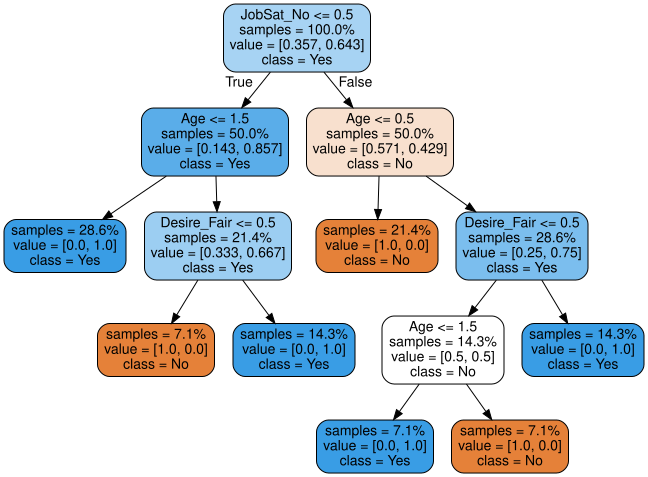

In [16]:
import graphviz
from sklearn import tree

dot_data = tree.export_graphviz(dt_clf, out_file=None,
                           feature_names=X.columns,
                           class_names=enroll_df['Target'].unique(), impurity=False,
                           filled=True, rounded=True, proportion=True)
# Draw graph
graph = graphviz.Source(dot_data, format='png')  
graph

## Feature Importance

<font color='blue'>Create a list of feature importance and sort.

In [17]:
feature_list = pd.DataFrame({'feature':X.columns, 'value':dt_clf.feature_importances_})
feature_list_sorted = feature_list.sort_values('value')
feature_list_sorted

,feature,value
1,Income,0.000000
3,JobSat_Yes,0.000000
4,Desire_Excellent,0.000000
2,JobSat_No,0.200000
5,Desire_Fair,0.285185
0,Age,0.514815


Plot the feature importance

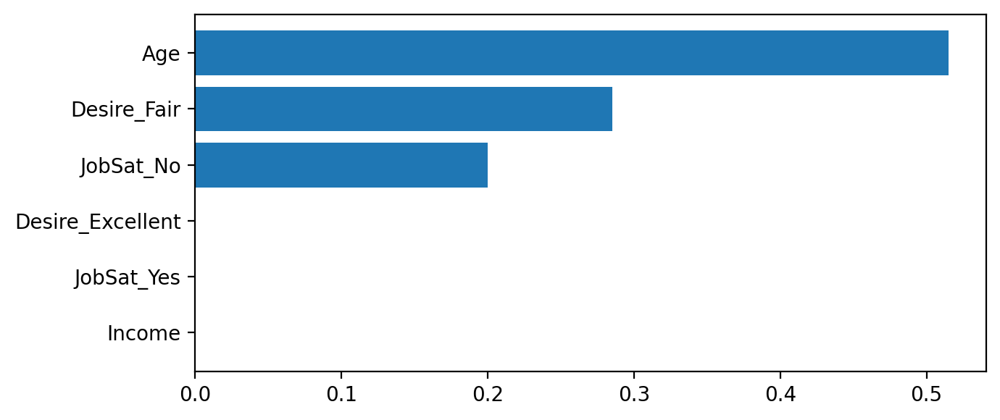

In [18]:
import matplotlib.pyplot as plt

plt.figure(figsize=(7,3))
plt.barh(range(0,len(feature_list_sorted.index)), 
         feature_list_sorted.value, tick_label=feature_list_sorted.feature)
plt.tight_layout();

# <font color='darkorange'> Your Turn -- CHURN dataset

## Load and explore data

In [19]:
churn_df = pd.read_excel('data/tree-based.xlsx', sheet_name='CHURN')

In [20]:
churn_df.head()

,state,account_length,area_code,phone_number,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,customer_service_calls,churn
0,KS,128.0,415,382-4657,no,yes,25,265.1,110.0,45.07,...,99,16.78,244.7,91.0,11.01,10.0,3,2.70,1,False
1,OH,107.0,415,371-7191,no,yes,26,161.6,123.0,27.47,...,103,16.62,254.4,103.0,11.45,13.7,3,3.70,1,False
2,NJ,137.0,415,358-1921,no,no,0,243.4,114.0,41.38,...,110,10.30,162.6,104.0,7.32,12.2,5,3.29,0,False
3,OH,84.0,408,375-9999,yes,no,0,299.4,71.0,50.90,...,88,5.26,196.9,89.0,8.86,6.6,7,1.78,2,False
4,OK,75.0,415,330-6626,yes,no,0,166.7,113.0,28.34,...,122,12.61,186.9,121.0,8.41,10.1,3,2.73,3,False


In [21]:
churn_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   state                   3333 non-null   object 
 1   account_length          3200 non-null   float64
 2   area_code               3333 non-null   int64  
 3   phone_number            3333 non-null   object 
 4   international_plan      3333 non-null   object 
 5   voice_mail_plan         3333 non-null   object 
 6   number_vmail_messages   3333 non-null   int64  
 7   total_day_minutes       3233 non-null   float64
 8   total_day_calls         3266 non-null   float64
 9   total_day_charge        3333 non-null   float64
 10  total_eve_minutes       3333 non-null   float64
 11  total_eve_calls         3333 non-null   int64  
 12  total_eve_charge        3333 non-null   float64
 13  total_night_minutes     3166 non-null   float64
 14  total_night_calls       3133 non-null   

In [22]:
churn_df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<font color='darkorange'>**Question**: What are your findings from the data exploration?

According to the profiling report, it provide the characteristics of dataset and some needed to be clean in data preprocessing part <br></br>

<b>1. High Correlation</b> 
between <br>
   - number_vmail_messages and voice_mail_plan
   - total_day_minutes and total_day_charge
   - total_eve_minutes and total_eve_charge
   - total_night_minutes and total_night_charge
   - total_intl_minutes and total_intl_charge <br></br>
   
<b>2. Imbalanced Feature</b> <br>
   - international_plan is highly imbalanced (54.1%) <br></br>
   
<b>3. Missing Data</b> <br>
   - account_length has 133 (4.0%) missing values
   - total_day_minutes has 100 (3.0%) missing values
   - total_day_calls has 67 (2.0%) missing values
   - total_night_minutes has 167 (5.0%) missing values
   - total_night_calls has 200 (6.0%) missing values<br></br>
   
<b>4. Unique Value</b> <br>
   - phone_number has unique values <br></br>
   
<b>5. Zero Value</b> <br>
   - number_vmail_messages has 2411 (72.3%) zeros
   - customer_service_calls has 697 (20.9%) zeros <br>

## Data preprocessing

- Drop unused/redundant columns based on the data profiling and rows with missing values.
- Appropriately encode categorical columns
- Split data into train and test sets with 70/30 ratio.

In [23]:
cdf = churn_df.copy()

In [24]:
cdf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   state                   3333 non-null   object 
 1   account_length          3200 non-null   float64
 2   area_code               3333 non-null   int64  
 3   phone_number            3333 non-null   object 
 4   international_plan      3333 non-null   object 
 5   voice_mail_plan         3333 non-null   object 
 6   number_vmail_messages   3333 non-null   int64  
 7   total_day_minutes       3233 non-null   float64
 8   total_day_calls         3266 non-null   float64
 9   total_day_charge        3333 non-null   float64
 10  total_eve_minutes       3333 non-null   float64
 11  total_eve_calls         3333 non-null   int64  
 12  total_eve_charge        3333 non-null   float64
 13  total_night_minutes     3166 non-null   float64
 14  total_night_calls       3133 non-null   

---
- Drop redundant columns

In [25]:
cdf = cdf.drop(['voice_mail_plan','total_day_minutes','total_eve_minutes','total_night_minutes',\
               'total_intl_minutes'],axis=1)

- Drop unused column

In [26]:
cdf = cdf.drop(['phone_number','state'],axis=1)

- Drop rows with misssing values

In [27]:
cdf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   account_length          3200 non-null   float64
 1   area_code               3333 non-null   int64  
 2   international_plan      3333 non-null   object 
 3   number_vmail_messages   3333 non-null   int64  
 4   total_day_calls         3266 non-null   float64
 5   total_day_charge        3333 non-null   float64
 6   total_eve_calls         3333 non-null   int64  
 7   total_eve_charge        3333 non-null   float64
 8   total_night_calls       3133 non-null   float64
 9   total_night_charge      3333 non-null   float64
 10  total_intl_calls        3333 non-null   int64  
 11  total_intl_charge       3333 non-null   float64
 12  customer_service_calls  3333 non-null   int64  
 13  churn                   3333 non-null   bool   
dtypes: bool(1), float64(7), int64(5), object

In [28]:
cdf.isnull().any()

account_length             True
area_code                 False
international_plan        False
number_vmail_messages     False
total_day_calls            True
total_day_charge          False
total_eve_calls           False
total_eve_charge          False
total_night_calls          True
total_night_charge        False
total_intl_calls          False
total_intl_charge         False
customer_service_calls    False
churn                     False
dtype: bool

In [29]:
cdf = cdf.dropna()

In [30]:
cdf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2943 entries, 0 to 3332
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   account_length          2943 non-null   float64
 1   area_code               2943 non-null   int64  
 2   international_plan      2943 non-null   object 
 3   number_vmail_messages   2943 non-null   int64  
 4   total_day_calls         2943 non-null   float64
 5   total_day_charge        2943 non-null   float64
 6   total_eve_calls         2943 non-null   int64  
 7   total_eve_charge        2943 non-null   float64
 8   total_night_calls       2943 non-null   float64
 9   total_night_charge      2943 non-null   float64
 10  total_intl_calls        2943 non-null   int64  
 11  total_intl_charge       2943 non-null   float64
 12  customer_service_calls  2943 non-null   int64  
 13  churn                   2943 non-null   bool   
dtypes: bool(1), float64(7), int64(5), object

- Encode categorical columns

In [31]:
cdf = pd.get_dummies(cdf, columns=['international_plan'])

In [32]:
cdf['area_code'].value_counts()

415    1452
408     754
510     737
Name: area_code, dtype: int64

In [33]:
cdf.rename({'churn':'Target'}, axis=1, inplace=True)
areacode_churn = [415,510,408]
cdf['area_code'] = cdf['area_code'].apply(lambda x: areacode_churn.index(x))

target_churn = [False, True]
cdf['Target']=cdf['Target'].apply(lambda x: target_churn.index(x))

In [34]:
X = cdf.drop('Target', axis=1)
Y = cdf[['Target']]
X
Y

,account_length,area_code,number_vmail_messages,total_day_calls,total_day_charge,total_eve_calls,total_eve_charge,total_night_calls,total_night_charge,total_intl_calls,total_intl_charge,customer_service_calls,international_plan_no,international_plan_yes
0,128.0,0,25,110.0,45.07,99,16.78,91.0,11.01,3,2.70,1,1,0
1,107.0,0,26,123.0,27.47,103,16.62,103.0,11.45,3,3.70,1,1,0
2,137.0,0,0,114.0,41.38,110,10.30,104.0,7.32,5,3.29,0,1,0
3,84.0,2,0,71.0,50.90,88,5.26,89.0,8.86,7,1.78,2,0,1
4,75.0,0,0,113.0,28.34,122,12.61,121.0,8.41,3,2.73,3,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3327,79.0,0,0,98.0,22.90,68,16.12,128.0,9.96,5,3.19,2,1,0
3328,192.0,0,36,77.0,26.55,126,18.32,83.0,12.56,6,2.67,2,1,0
3329,68.0,0,0,57.0,39.29,55,13.04,123.0,8.61,4,2.59,3,1,0
3331,184.0,1,0,105.0,36.35,84,13.57,137.0,6.26,10,1.35,2,0,1


,Target
0,0
1,0
2,0
3,0
4,0
...,...
3327,0
3328,0
3329,0
3331,0


- Split data into train and test sets with 70/30 ratio.

In [35]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=0)

## Model fitting and prediction
Fit the decision tree classifier with default hypermeters to the train data. 

In [36]:
dtclf = DecisionTreeClassifier()
dtclf.fit(X_train, y_train)

DecisionTreeClassifier()

In [37]:
dtclf.predict(X_test)
dtclf.predict_proba(X_test)

array([0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1,
       0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       ...,
       [1., 0.],
       [1., 0.],
       [0., 1.]])

- Performance Evaluation

In [38]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test, dtclf.predict(X_test))

0.8980747451868629

In [39]:
from sklearn.metrics import classification_report
print(classification_report(y_test, dtclf.predict(X_test)))

              precision    recall  f1-score   support

           0       0.96      0.92      0.94       762
           1       0.60      0.74      0.67       121

    accuracy                           0.90       883
   macro avg       0.78      0.83      0.80       883
weighted avg       0.91      0.90      0.90       883



In [40]:
from sklearn.metrics import confusion_matrix
confusion_matrix(y_test, dtclf.predict(X_test))

array([[703,  59],
       [ 31,  90]])

## Visualizing results
- Print out the decision rules
- Print out the fitted decision tree
- Show the feature importance plot

---
- The decision rules

In [41]:
text_representation = tree.export_text(dtclf)
print(text_representation)

|--- feature_4 <= 45.19
|   |--- feature_11 <= 3.50
|   |   |--- feature_13 <= 0.50
|   |   |   |--- feature_4 <= 37.95
|   |   |   |   |--- feature_6 <= 29.00
|   |   |   |   |   |--- feature_3 <= 124.50
|   |   |   |   |   |   |--- feature_8 <= 15.91
|   |   |   |   |   |   |   |--- feature_5 <= 73.50
|   |   |   |   |   |   |   |   |--- feature_3 <= 64.50
|   |   |   |   |   |   |   |   |   |--- feature_8 <= 9.18
|   |   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |   |   |--- feature_8 >  9.18
|   |   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |--- feature_3 >  64.50
|   |   |   |   |   |   |   |   |   |--- feature_7 <= 65.50
|   |   |   |   |   |   |   |   |   |   |--- feature_4 <= 34.32
|   |   |   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |   |   |   |--- feature_4 >  34.32
|   |   |   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |   |--- feature_7 > 

- The fitted decision tree

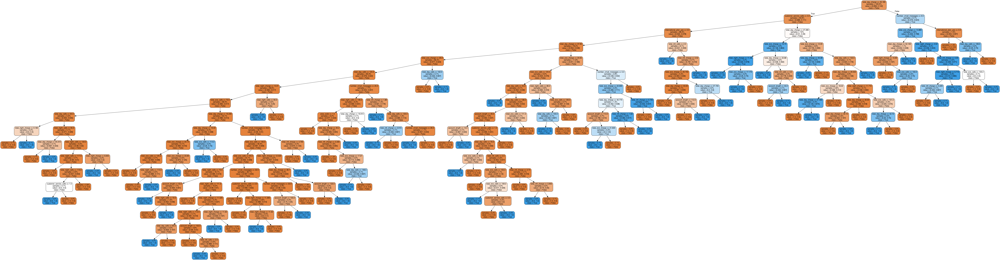

In [42]:
from IPython.display import Image 
dot_data = tree.export_graphviz(dtclf, out_file=None,
                           feature_names=X.columns,
                           class_names=churn_df['churn'].astype(str).unique(), impurity=False,
                           filled=True, rounded=True, proportion=True)
# Draw graph
graph = graphviz.Source(dot_data, format='png')  
Image(graph.view())

- Feature importance

In [43]:
feature_list = pd.DataFrame({'feature':X.columns, 'value':dtclf.feature_importances_})
feature_list_sorted = feature_list.sort_values('value')
feature_list_sorted

,feature,value
12,international_plan_no,0.000000
1,area_code,0.000839
0,account_length,0.023644
7,total_night_calls,0.026595
5,total_eve_calls,0.035183
3,total_day_calls,0.038780
8,total_night_charge,0.040259
13,international_plan_yes,0.065979
9,total_intl_calls,0.067687
2,number_vmail_messages,0.073092


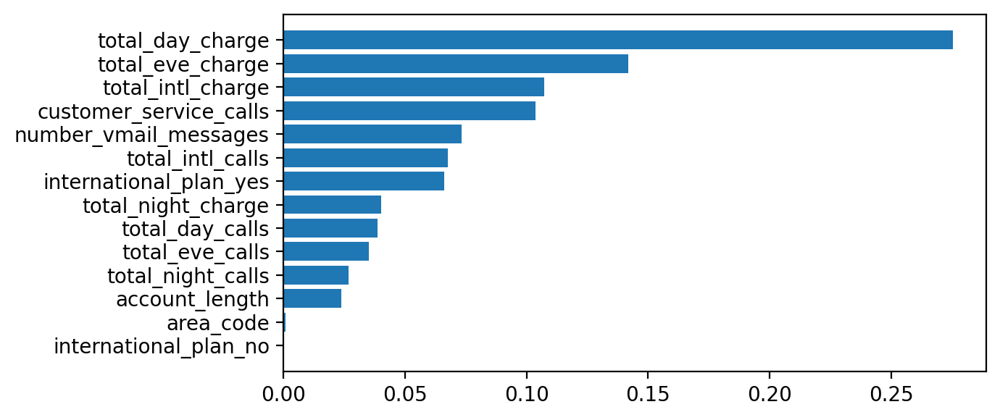

In [44]:
plt.figure(figsize=(7,3))
plt.barh(range(0,len(feature_list_sorted.index)), 
         feature_list_sorted.value, tick_label=feature_list_sorted.feature)
plt.tight_layout();

## Model Tuning

- Perform Grid-search CV on `criterion`, `max_depth`, `max_features`, `splitter` by using F1
as the scoring metric.
- Show the tuned hyperparameter sets and the corresponding scores.
- Perform K-fold CV on the whole dataset using the tuned hyperparameters and compare the performance
results with the untuned model.
- Display the decision tree of the tuned model.

---
- Perform Grid-search CV on `criterion`, `max_depth`, `max_features`, `splitter` by using F1
as the scoring metric.

In [45]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, f1_score
param_grid = {
        'criterion' : ['gini', 'entropy', 'log_loss'],
        'max_depth' : [5,6,7,8,9,10],
        'max_features' : ['auto', 'sqrt', 'log2', None],
        'splitter' : ['best','random']
  }
dt_gridsearch = GridSearchCV(DecisionTreeClassifier(), param_grid, 
                             scoring=make_scorer(f1_score,average='micro'))
dt_gridsearch.fit(X_train, y_train)

GridSearchCV(estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [5, 6, 7, 8, 9, 10],
                         'max_features': ['auto', 'sqrt', 'log2', None],
                         'splitter': ['best', 'random']},
             scoring=make_scorer(f1_score, average=micro))

- Show the tuned hyperparameter sets and the corresponding scores.

In [46]:
pd.DataFrame(dt_gridsearch.cv_results_).sort_values('mean_test_score', ascending=False)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_max_features,param_splitter,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
62,0.009934,0.001261,0.002284,0.000384,entropy,6,None,best,"{'criterion': 'entropy', 'max_depth': 6, 'max_...",0.939320,0.934466,0.958738,0.922330,0.944175,0.939806,0.011930,1
14,0.009556,0.001370,0.003005,0.001101,gini,6,None,best,"{'criterion': 'gini', 'max_depth': 6, 'max_fea...",0.941748,0.934466,0.958738,0.924757,0.927184,0.937379,0.012223,2
54,0.009824,0.001314,0.002960,0.001701,entropy,5,None,best,"{'criterion': 'entropy', 'max_depth': 5, 'max_...",0.946602,0.936893,0.941748,0.929612,0.927184,0.936408,0.007265,3
70,0.009571,0.000455,0.001945,0.000201,entropy,7,None,best,"{'criterion': 'entropy', 'max_depth': 7, 'max_...",0.941748,0.936893,0.946602,0.922330,0.934466,0.936408,0.008181,3
6,0.012953,0.001781,0.004785,0.001841,gini,5,None,best,"{'criterion': 'gini', 'max_depth': 5, 'max_fea...",0.939320,0.936893,0.946602,0.927184,0.932039,0.936408,0.006585,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139,0.002670,0.000855,0.000000,0.000000,log_loss,10,sqrt,random,"{'criterion': 'log_loss', 'max_depth': 10, 'ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,115
140,0.002260,0.000036,0.000000,0.000000,log_loss,10,log2,best,"{'criterion': 'log_loss', 'max_depth': 10, 'ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,107
141,0.002905,0.000351,0.000000,0.000000,log_loss,10,log2,random,"{'criterion': 'log_loss', 'max_depth': 10, 'ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,117
142,0.002327,0.000210,0.000000,0.000000,log_loss,10,None,best,"{'criterion': 'log_loss', 'max_depth': 10, 'ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,122


In [47]:
dt_gridsearch.best_params_    # Tuned hyperparameters
dt_gridsearch.best_score_     # Best score
dt_gridsearch.best_estimator_ # Tuned model

{'criterion': 'entropy',
 'max_depth': 6,
 'max_features': None,
 'splitter': 'best'}

0.9398058252427186

DecisionTreeClassifier(criterion='entropy', max_depth=6)

- Perform K-fold CV on the whole dataset using the tuned hyperparameters and compare the performance results with the untuned model.

<b><font color='blue'>Tuned model</font></b>

In [48]:
from sklearn.model_selection import cross_validate
scoring_metrics = ['accuracy','precision_macro','recall_macro', 'f1_macro']
tuned_clf = DecisionTreeClassifier(criterion='entropy', max_depth=6)
tuned_scores = cross_validate(tuned_clf, X_train, y_train,
                         scoring=scoring_metrics, cv = 5, return_train_score= False)
tuned_scores_df = pd.DataFrame(tuned_scores)
tuned_scores_df
tuned_scores_df.mean()

,fit_time,score_time,test_accuracy,test_precision_macro,test_recall_macro,test_f1_macro
0,0.011360,0.008954,0.941748,0.917367,0.829145,0.865732
1,0.015952,0.003896,0.934466,0.873942,0.846532,0.859444
2,0.009158,0.003477,0.958738,0.929081,0.898281,0.912824
3,0.008617,0.003674,0.922330,0.854652,0.813511,0.832136
4,0.016876,0.003666,0.944175,0.921062,0.840375,0.874482


fit_time                0.012393
score_time              0.004734
test_accuracy           0.940291
test_precision_macro    0.899221
test_recall_macro       0.845569
test_f1_macro           0.868924
dtype: float64

<b><font color='blue'>Untuned model</font></b>

In [49]:
scoring_metrics = ['accuracy','precision_macro','recall_macro', 'f1_macro']
untuned_scores = cross_validate(DecisionTreeClassifier(), X_train, y_train,
                         scoring=scoring_metrics, cv = 5, return_train_score= False)
untuned_scores_df = pd.DataFrame(untuned_scores)
untuned_scores_df
untuned_scores_df.mean()

,fit_time,score_time,test_accuracy,test_precision_macro,test_recall_macro,test_f1_macro
0,0.018589,0.004214,0.917476,0.822123,0.858270,0.838618
1,0.012747,0.003604,0.893204,0.776761,0.815313,0.793878
2,0.011421,0.006261,0.919903,0.831448,0.854444,0.842316
3,0.013827,0.003629,0.895631,0.786837,0.790872,0.788831
4,0.012584,0.003580,0.902913,0.799609,0.816296,0.807576


fit_time                0.013834
score_time              0.004258
test_accuracy           0.905825
test_precision_macro    0.803356
test_recall_macro       0.827039
test_f1_macro           0.814244
dtype: float64

- Display the decision tree of the tuned model.

In [50]:
tuned_clf.fit(X_train,y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=6)

In [51]:
text_representation = tree.export_text(tuned_clf)
print(text_representation)

|--- feature_4 <= 43.50
|   |--- feature_11 <= 3.50
|   |   |--- feature_13 <= 0.50
|   |   |   |--- feature_4 <= 37.95
|   |   |   |   |--- feature_6 <= 29.00
|   |   |   |   |   |--- feature_6 <= 14.34
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |--- feature_6 >  14.34
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |--- feature_6 >  29.00
|   |   |   |   |   |--- feature_8 <= 10.39
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |--- feature_8 >  10.39
|   |   |   |   |   |   |--- class: 1
|   |   |   |--- feature_4 >  37.95
|   |   |   |   |--- feature_6 <= 20.50
|   |   |   |   |   |--- feature_3 <= 109.50
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |--- feature_3 >  109.50
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |--- feature_6 >  20.50
|   |   |   |   |   |--- feature_2 <= 5.50
|   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |--- feature_2 >  5.50
|   |   |   |   |   |   |--- class: 0
|   |   |--- feature_13 >  0

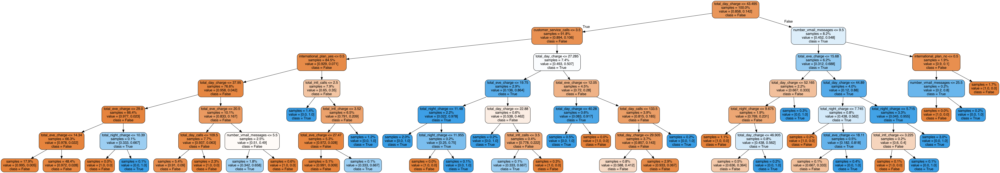

In [52]:
from IPython.display import Image 
dot_data = tree.export_graphviz(tuned_clf, out_file=None,
                           feature_names=X.columns,
                           class_names=churn_df['churn'].astype(str).unique(), impurity=False,
                           filled=True, rounded=True, proportion=True)
# Draw graph
graph = graphviz.Source(dot_data, format='png') 
Image(graph.view())